# Camera Calibration
* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.

In [1]:
# Global Variables for running noteobok with outputs to help tuning

PERFORMONPICTURES = 1

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import glob
import matplotlib.image as mping

#Calibrating Camera Lecture

cal_images = glob.glob('camera_cal/*.jpg')

objpoints = []
imgpoints = []

# prepare object points
objp = np.zeros((9*6,3),np.float32)
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2)

for fname in cal_images:
        # Read Image
        image = mping.imread(fname)
        # Convert to gray scale
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        # Find Chess Board Corners
        ret, corners = cv2.findChessboardCorners(gray, (9, 6), None)
        # If Corners are found, add object points, and image points
        if ret == True:
            imgpoints.append(corners)
            objpoints.append(objp)
            if(PERFORMONPICTURES):
                img = cv2.drawChessboardCorners(image, (9,6), corners, ret)
                plt.imshow(img)
                plt.show()
        elif(PERFORMONPICTURES):
            print("Corners not found")
            plt.imshow(image)
            plt.show()
        
def undistortImage(img, objpoints, imgpoints):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    undist=cv2.undistort(img, mtx, dist, None, mtx)
    return undist

if(PERFORMONPICTURES):
    for fname in cal_images:
        image = cv2.imread(fname)
        undist = undistortImage(image, objpoints, imgpoints)
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(image)
        ax1.set_title('Original Image', fontsize=50)
        ax2.imshow(undist)
        ax2.set_title('Undistorted Image', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        plt.show()


Corners not found


Corners not found


Corners not found


* Apply a distortion correction to raw images.


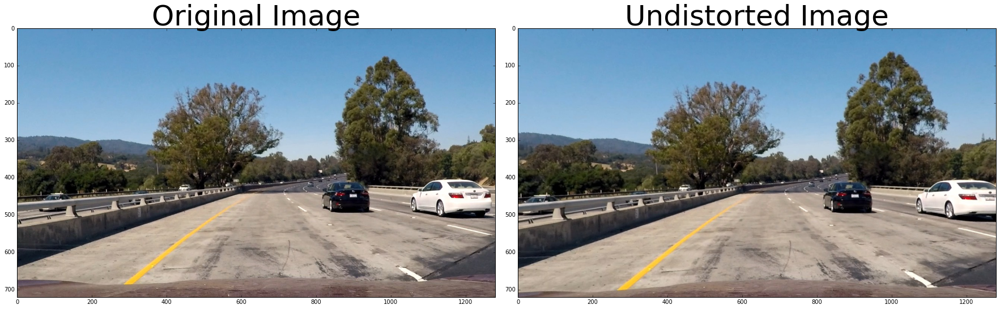

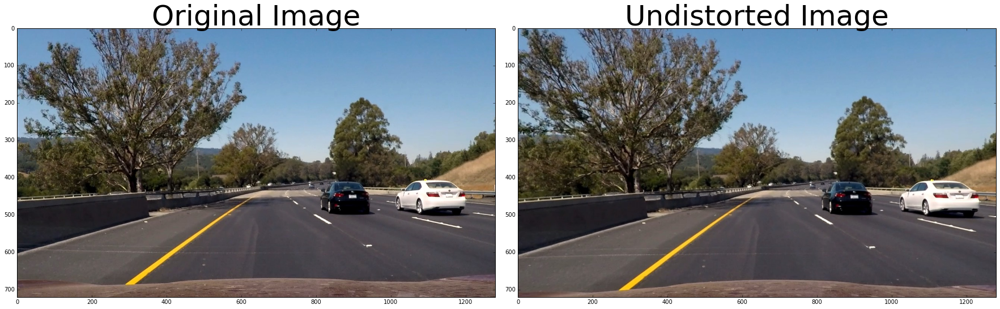

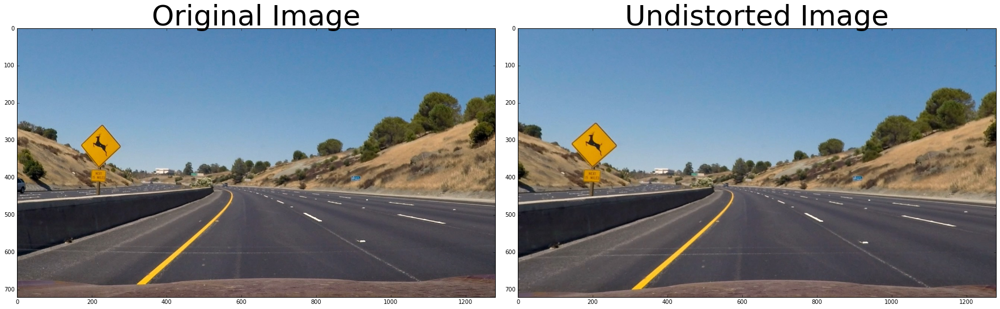

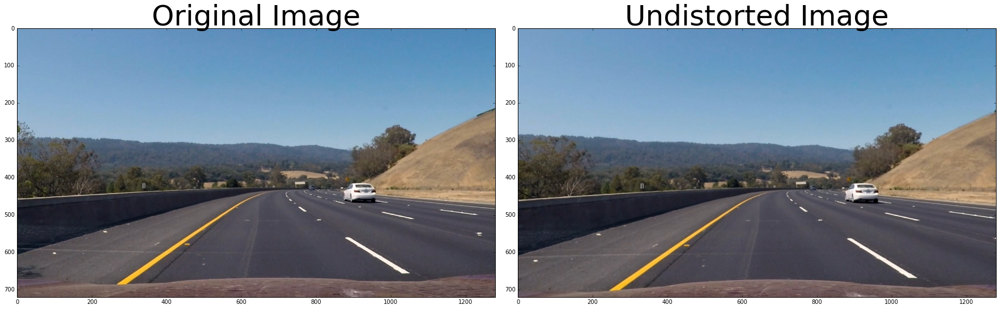

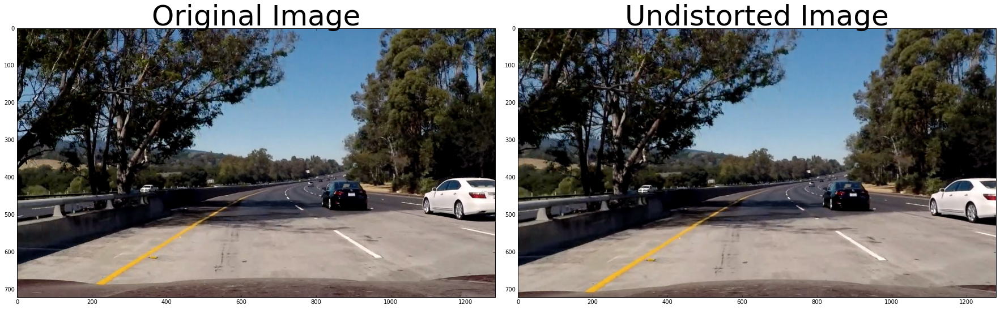

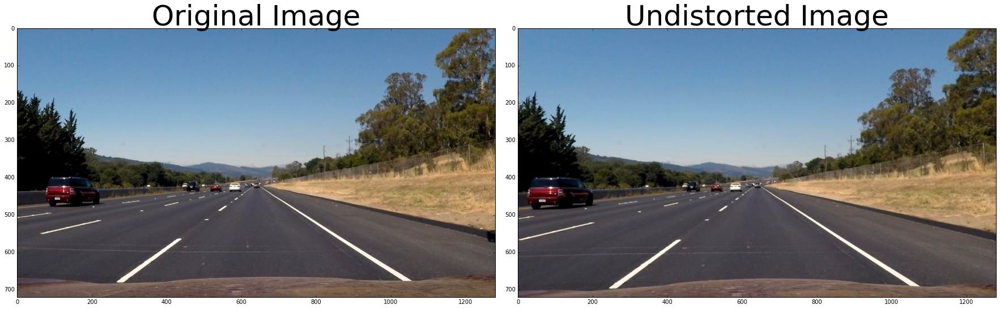

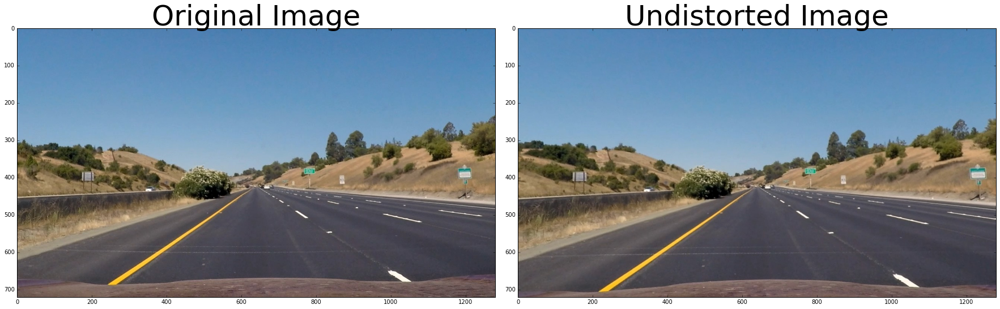

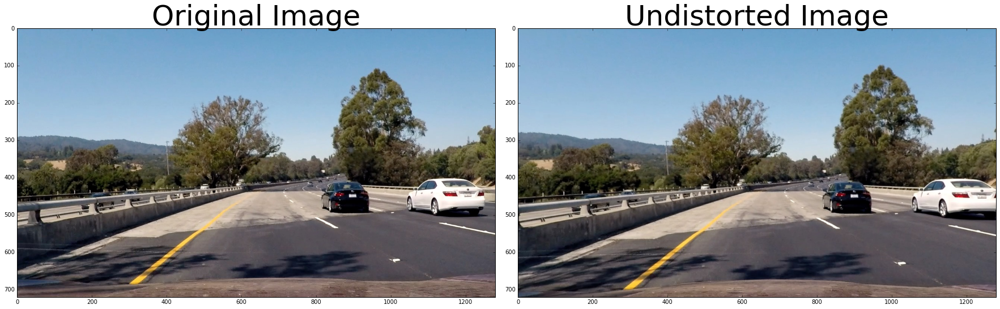

In [4]:
test_images = glob.glob('test_images/*.jpg')

for fname in test_images:
    image = mping.imread(fname)
    undist = undistortImage(image, objpoints, imgpoints)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(undist)
    ax2.set_title('Undistorted Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()



# Color transormations, gradients, and thresholding
* Use color transforms, gradients, etc., to create a thresholded binary image.


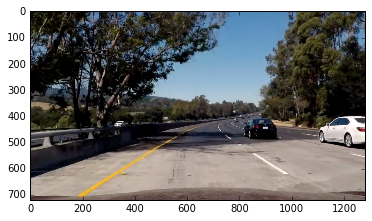

R_Channel


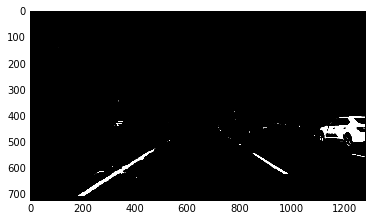

s_channel


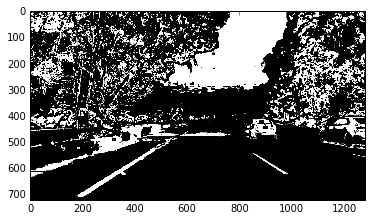

S and R


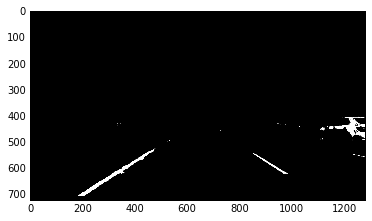

gradx


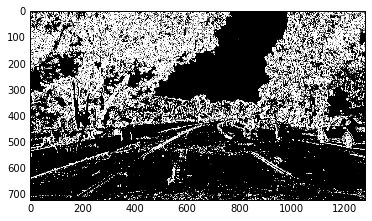

Gradx on s channel


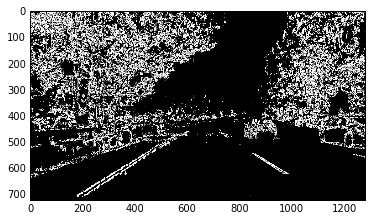

Gradx on R channel


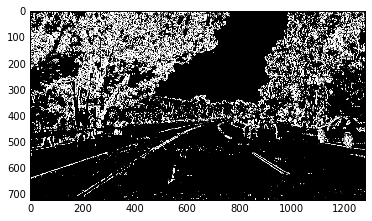

grady


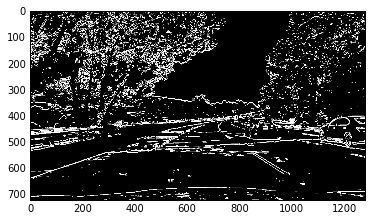

mag_binary


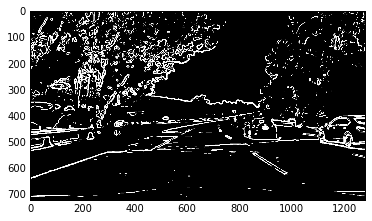

s_channel mag_binary


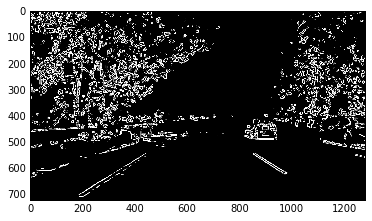

Red mag_binary


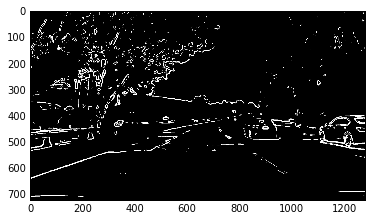

dir_binary


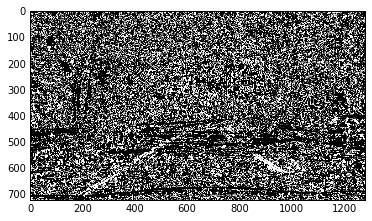

combined


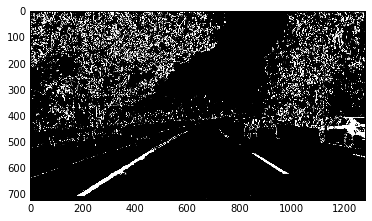

Color Binary


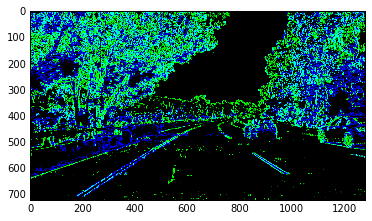

In [5]:
# Combining Thresholds Lecture
# Exploring different methods with single picture

def abs_sobel_thresh(gray, orient='x', sobel_kernel=3, thresh=(0, 255)):
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    # Return the result
    return binary_output

def mag_threshold(gray, sobel_kernel=3, thresh=(0, 255)):
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= thresh[0]) & (gradmag <= thresh[1])] = 1

    # Return the binary image
    return binary_output

def dir_threshold(gray, sobel_kernel=3, thresh=(0, np.pi/2)):
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize = sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize = sobel_kernel)
    # 3) Take the absolute value of the x and y gradients
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    # 5) Create a binary mask where direction thresholds are met
    binary_output = np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    return binary_output

def Threshold(img, thresh=(0, 255)):
    # 2) Apply a threshold
    result = np.zeros_like(img)
    result[(img > thresh[0]) & (img <= thresh[1])] = 1
    # 3) Return a binary image of threshold result
    return result

if(PERFORMONPICTURES):
    # Choose a Sobel kernel size
    ksize = 13  # Choose a larger odd number to smooth gradient measurements

    image = mping.imread(test_images[4])
    undist = undistortImage(image, objpoints, imgpoints)
    image = undist
    plt.imshow(image)
    plt.show()
    
    R = image[:,:,0]

    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)

    s_channel = hls[:,:,2]
    
    print("R_Channel")
    plt.imshow(Threshold(R,(205,255)), cmap = 'gray')
    plt.show()

    print("s_channel")
    plt.imshow(Threshold(s_channel,(95,255)), cmap = 'gray')
    plt.show()
    
    combined = np.zeros_like(Threshold(s_channel))
    combined[(Threshold(s_channel,(95,255)) == 1) & (Threshold(R,(205,255)) == 1)] = 1
    
    print("S and R")
    plt.imshow(combined, cmap = 'gray')
    plt.show()

    # Apply each of the thresholding functions
    gradx = abs_sobel_thresh(gray, orient='x', sobel_kernel=ksize, thresh=(5, 100))
    print("gradx")
    plt.imshow(gradx, cmap='gray')
    plt.show()

    gradxs = abs_sobel_thresh(s_channel, orient='x', sobel_kernel=ksize, thresh = (15,120))
    print("Gradx on s channel")
    plt.imshow(gradxs, cmap='gray')
    plt.show()

    gradxr = abs_sobel_thresh(R, orient='x', sobel_kernel=ksize, thresh = (10,120))
    print("Gradx on R channel")
    plt.imshow(gradxr, cmap='gray')
    plt.show()
    
    grady = abs_sobel_thresh(gray, orient='y', sobel_kernel=ksize, thresh=(20, 150))
    print("grady")
    plt.imshow(grady, cmap='gray')
    plt.show()

    mag_binary = mag_threshold(gray, sobel_kernel=ksize, thresh=(45, 175))
    print("mag_binary")
    plt.imshow(mag_binary, cmap='gray')
    plt.show()

    mag_binary_s = mag_threshold(s_channel, sobel_kernel=ksize, thresh=(85, 175))
    print("s_channel mag_binary")
    plt.imshow(mag_binary_s, cmap='gray')
    plt.show()
    
    mag_binary_r = mag_threshold(R, sobel_kernel=ksize, thresh=(65, 175))
    print("Red mag_binary")
    plt.imshow(mag_binary_r, cmap='gray')
    plt.show()
    

    dir_binary = dir_threshold(gray, sobel_kernel=ksize, thresh=(.7, 1.25)) 
    print("dir_binary")
    plt.imshow(dir_binary, cmap='gray')
    plt.show()

    combined = np.zeros_like(dir_binary)
    #combined[(gradxr == 1) & (gradxs == 1)] = 1
    combined[((Threshold(s_channel,(95,255)) == 1) & (Threshold(R,(205,255)) == 1)) | ((gradxr == 1) & (gradxs == 1))] = 1
    #combined[((mag_binary == 1) & (dir_binary == 1)) | (gradx == 1) | (Threshold(s_channel,(120,255)) == 1)] = 1

    color_binary = np.zeros_like(gradx)
    color_binary = np.dstack(( np.zeros_like(gradx), gradxr, gradxs)) * 255

    print("combined")
    plt.imshow(combined, cmap = 'gray')
    plt.show()
    print("Color Binary")
    plt.imshow(color_binary)
    plt.show()


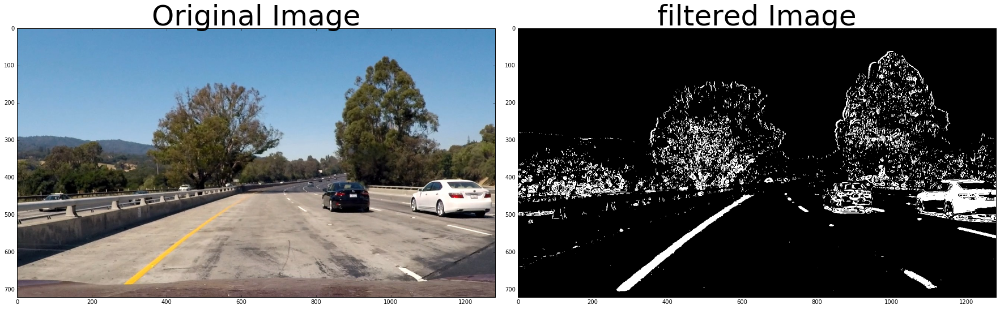

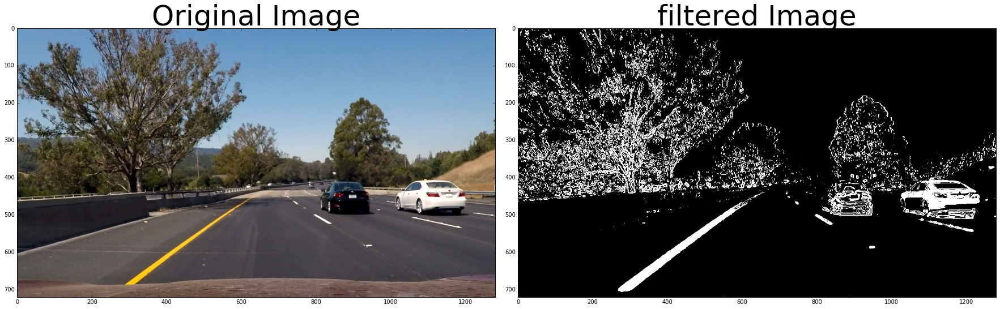

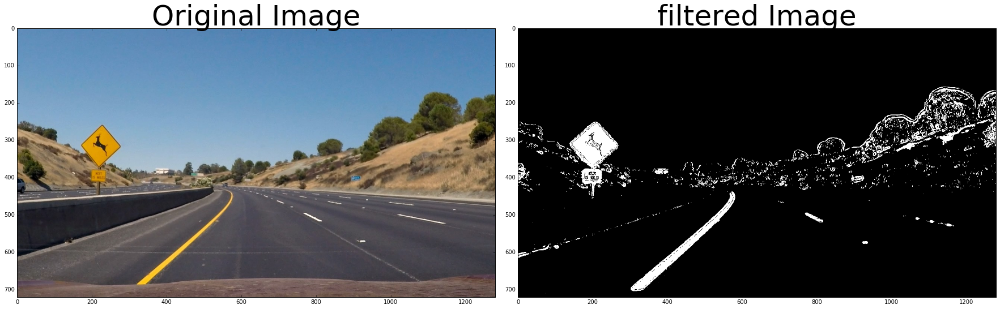

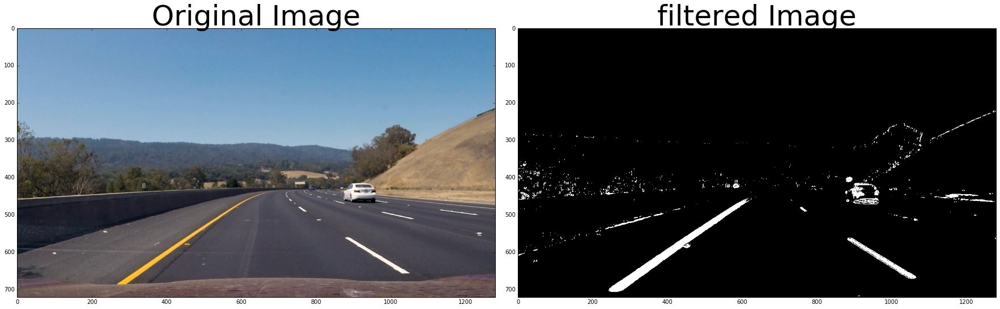

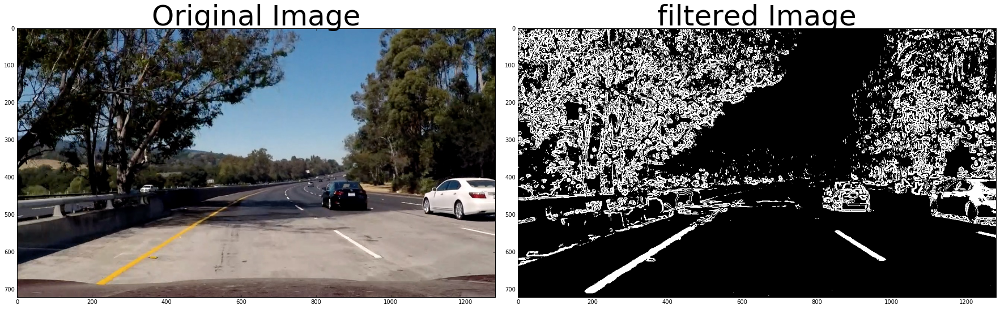

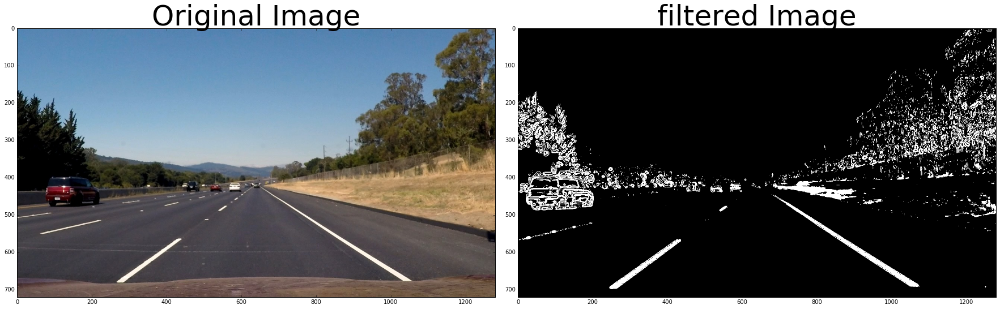

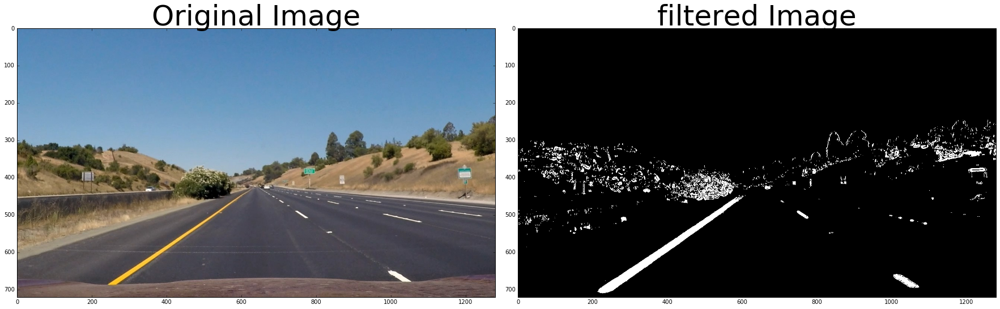

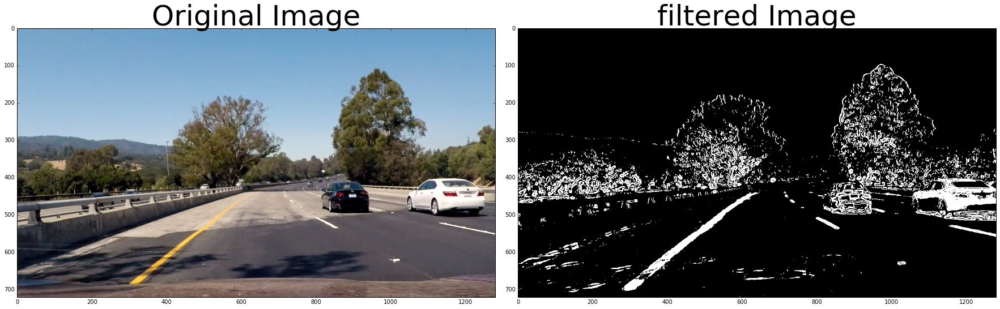

In [6]:
def LightFilter(img, ksize=13, sx_thresh=(20, 100), mag_thresh = (45, 175), dir_thresh = (0.7, 1.25)):
    img = np.copy(img)
    # Convert to Gray
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    # Sobel x on s
    sobelx_s = abs_sobel_thresh(s_channel, orient='x', sobel_kernel=ksize, thresh=sx_thresh)
    
    # Magnitude and direction on gray
    mag_binary_gray = mag_threshold(gray, sobel_kernel=ksize, thresh=mag_thresh)
    dir_binary_gray = dir_threshold(gray, sobel_kernel=ksize, thresh=dir_thresh) 
    
    # Combine
    binary = np.zeros_like(sobelx_s)
    binary[((mag_binary_gray == 1) & (dir_binary_gray == 1)) | (sobelx_s == 1)] = 1
    
    return binary

def HeavyFilter(img, ksize = 13, mag_thresh = (45, 175), dir_thresh = (0.7, 1.25)):
    img = np.copy(img)
    #Get red channel
    r_channel = img[:,:,0]
    
    # Convert to HLS color space and separate the S channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    
    R = Threshold(r_channel,(205,255))

    S = Threshold(s_channel,(95,255))
    
    gradxs = abs_sobel_thresh(s_channel, orient='x', sobel_kernel=ksize, thresh = (15,120))
    
    gradxr = abs_sobel_thresh(r_channel, orient='x', sobel_kernel=ksize, thresh = (10,120))
        
    mag_binary_s = mag_threshold(s_channel, sobel_kernel=ksize, thresh=(65, 175))
    
    combined = np.zeros_like(R)
    combined[((S == 1) & (R == 1)) | (mag_binary_s == 1) | ((gradxs == 1) & (gradxr == 1))] = 1
    
    return combined
        
def Pipeline(image):
    undist = undistortImage(image, objpoints, imgpoints)
    return HeavyFilter(undist)

if(PERFORMONPICTURES):
    for fname in test_images:
        image = mping.imread(fname)

        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(image)
        ax1.set_title('Original Image', fontsize=50)
        ax2.imshow(Pipeline(image), cmap = 'gray')
        ax2.set_title('filtered Image', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        plt.show()


* Apply a perspective transform to rectify binary image ("birds-eye view").

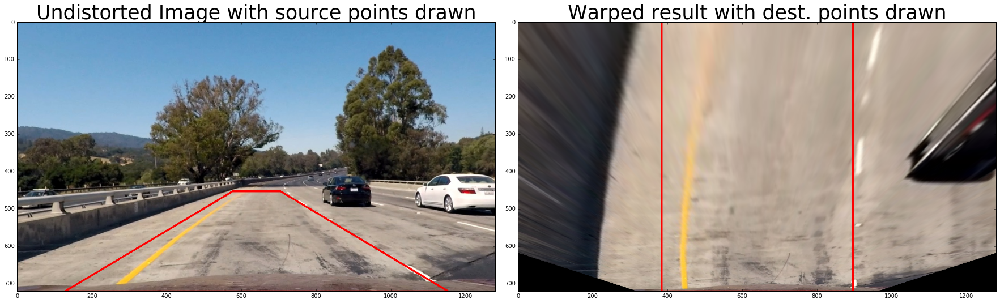

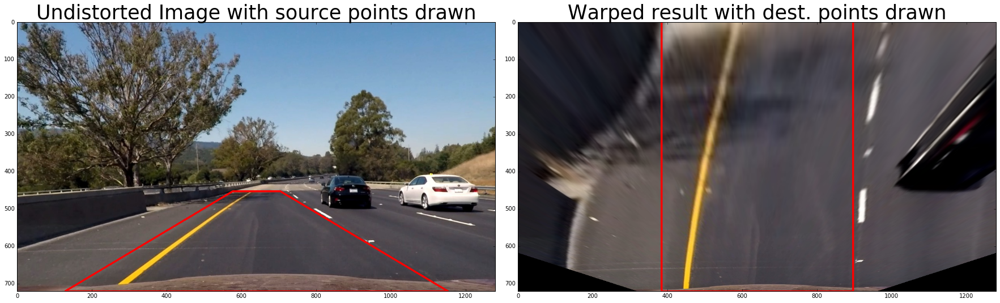

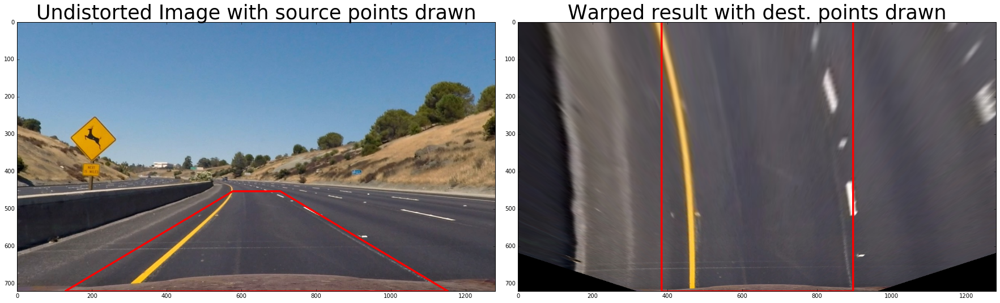

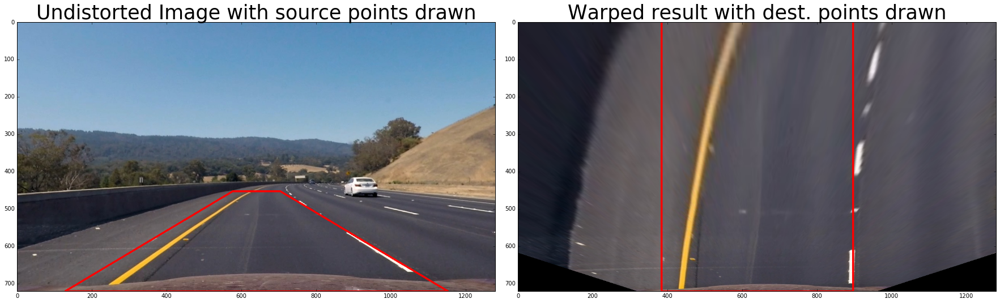

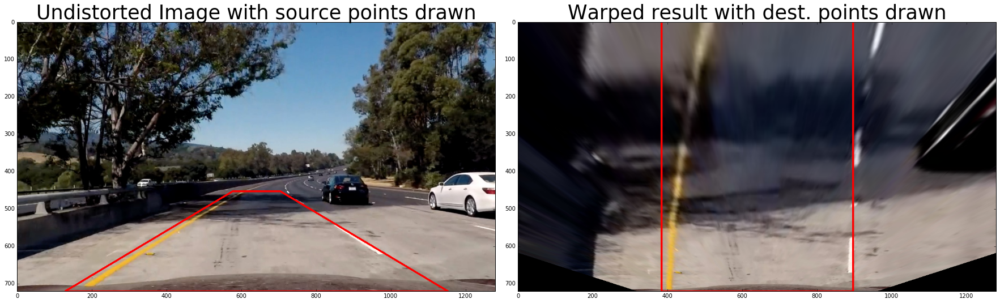

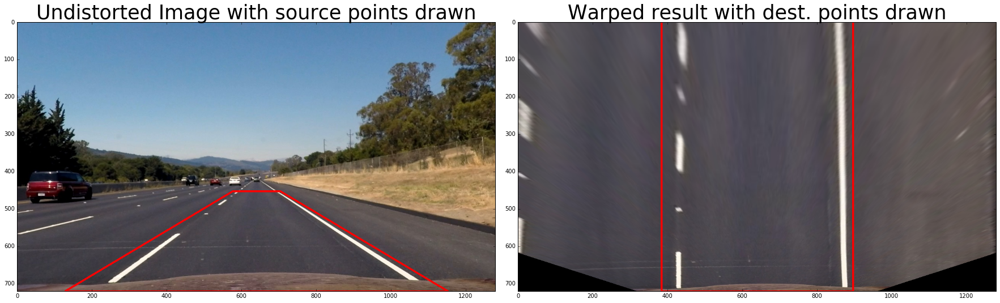

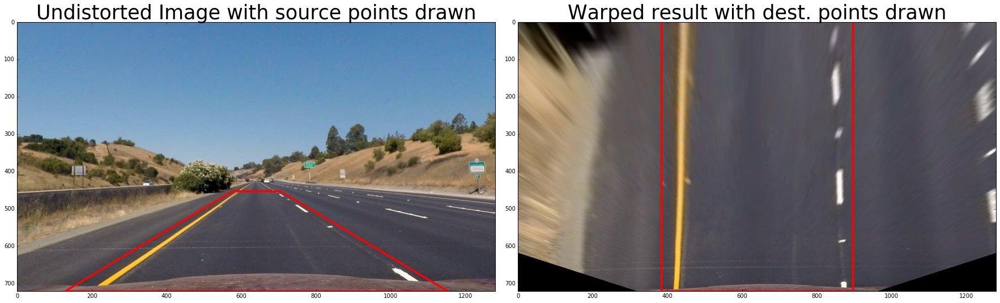

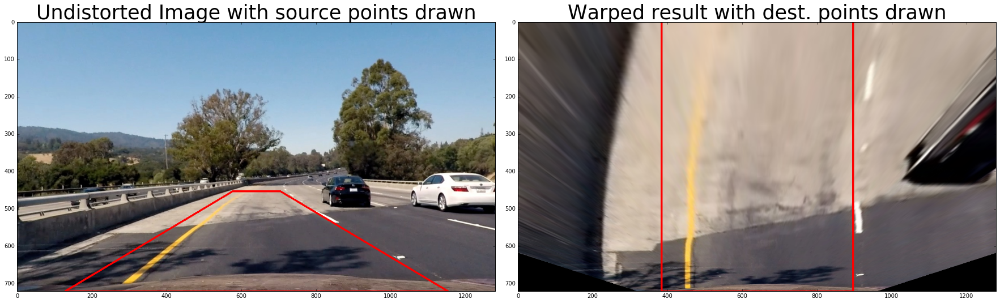

In [7]:
def Warp_Test(image):
    img_size = (image.shape[1], image.shape[0])
    # Move points around more to get better transformation
    src = np.float32(
        [[img_size[0] * 0.45, img_size[1] * 0.63],
        [ img_size[0] * .1, img_size[1]],
        [ img_size[0] * .9, img_size[1]],
        [ img_size[0] * 0.55, img_size[1] * 0.63]])

    dst = np.float32(
        [[img_size[0] * 0.3, 0],
        [img_size[0] * 0.3, img_size[1]],
        [img_size[0] * 0.7, img_size[1]],
        [img_size[0] * 0.7, 0]])

    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(image, M, img_size)
    return(src, dst, warped, Minv)

def Warp(image):
    src, dest, warped, Minv = Warp_Test(image)
    return (warped, Minv)

if(PERFORMONPICTURES):
    for fname in test_images:
        image = mping.imread(fname)
        image = undistortImage(image, objpoints, imgpoints)
        
        img_size = (image.shape[1], image.shape[0])

        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        src, dst, warp_image, Minv = Warp_Test(image)
        
        #Draw lines on output image
        cv2.line(warp_image, (dst[0][0],dst[0][1]), (dst[1][0],dst[1][1]), (255, 0, 0), thickness=3, lineType=8) 
        cv2.line(warp_image, (dst[1][0],dst[1][1]), (dst[2][0],dst[2][1]), (255, 0, 0), thickness=3, lineType=8) 
        cv2.line(warp_image, (dst[2][0],dst[2][1]), (dst[3][0],dst[3][1]), (255, 0, 0), thickness=3, lineType=8) 
        cv2.line(warp_image, (dst[3][0],dst[3][1]), (dst[0][0],dst[0][1]), (255, 0, 0), thickness=3, lineType=8) 
        
        ax2.imshow(warp_image, cmap = 'gray')
        ax2.set_title('Warped result with dest. points drawn', fontsize=35)

        cv2.line(image, (src[0][0],src[0][1]), (src[1][0],src[1][1]), (255, 0, 0), thickness=3, lineType=8) 
        cv2.line(image, (src[1][0],src[1][1]), (src[2][0],src[2][1]), (255, 0, 0), thickness=3, lineType=8) 
        cv2.line(image, (src[2][0],src[2][1]), (src[3][0],src[3][1]), (255, 0, 0), thickness=3, lineType=8) 
        cv2.line(image, (src[3][0],src[3][1]), (src[0][0],src[0][1]), (255, 0, 0), thickness=3, lineType=8) 

        ax1.imshow(image)
        ax1.set_title('Undistorted Image with source points drawn', fontsize=35)

        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        plt.show()


(1280,)
442
903


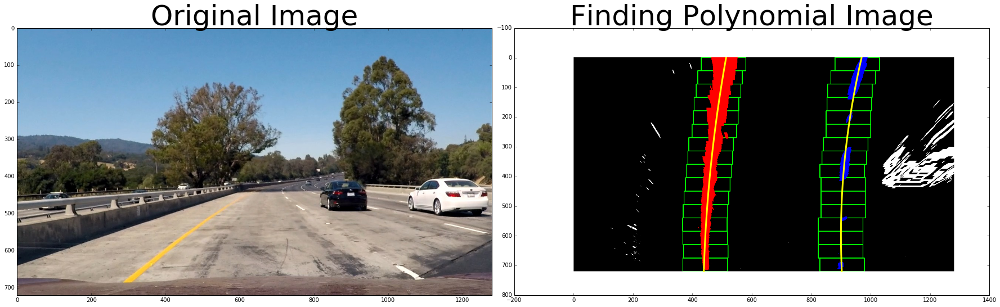

(1280,)
461
914


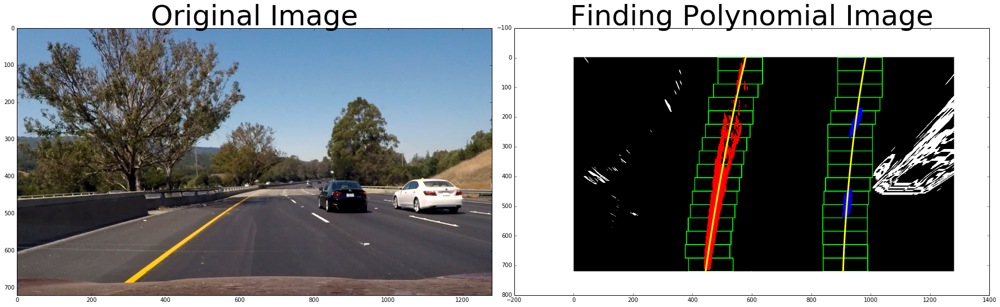

(1280,)
464
884


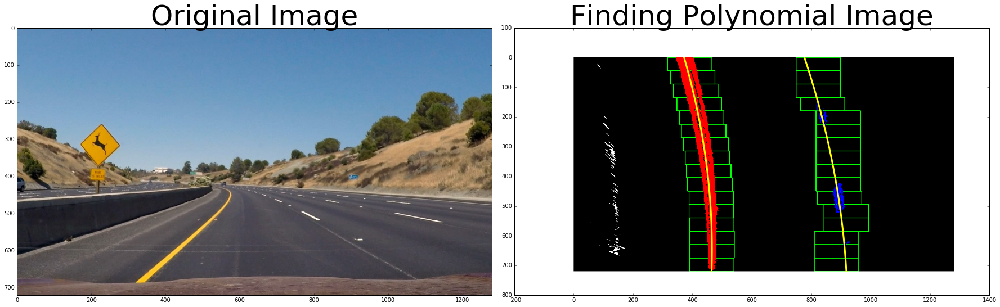

(1280,)
448
893


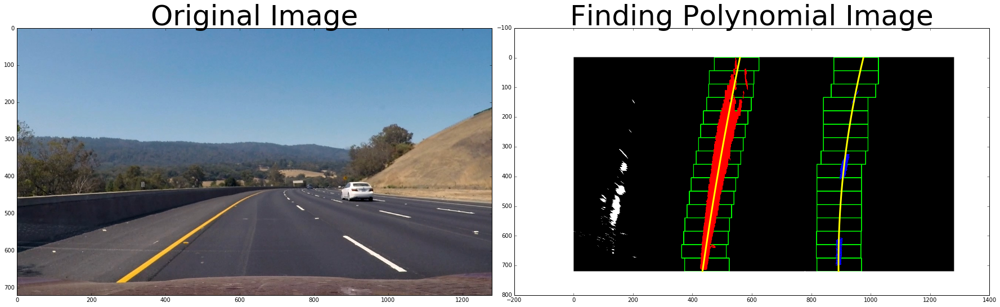

(1280,)
411
890


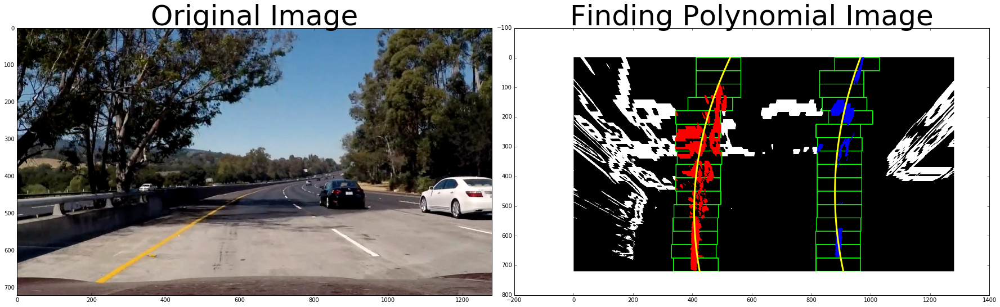

(1280,)
426
868


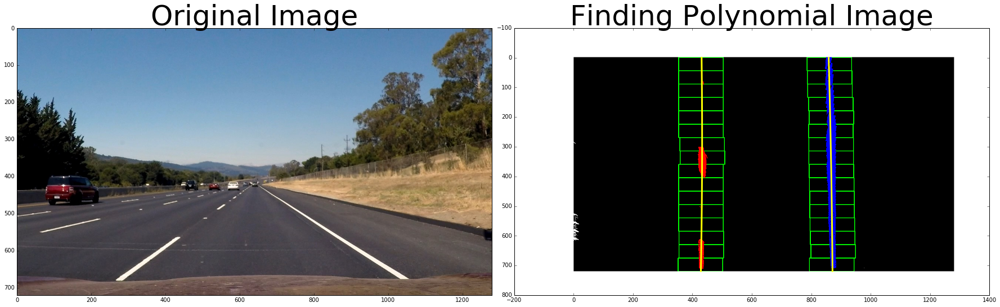

(1280,)
425
863


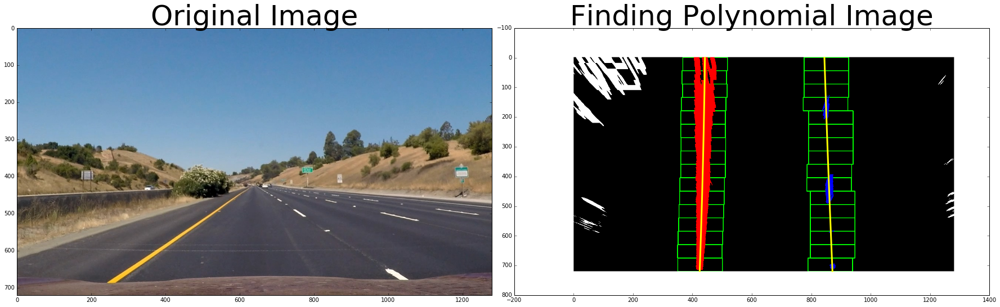

(1280,)
462
911


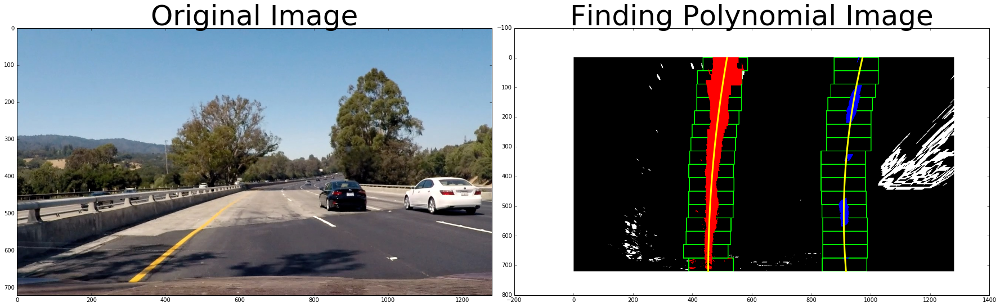

In [22]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

def find_lane_pixels_verbose(binary_warped, ax):  
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[int(binary_warped.shape[0]*0.65):,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    print(histogram.shape)
    print(leftx_base)
    print(rightx_base)
    
    # Choose the number of sliding windows
    nwindows = 16
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 75
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
        (0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
        (0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    ax.imshow(out_img)
    ax.plot(left_fitx, ploty, color='yellow', linewidth = 3)
    ax.plot(right_fitx, ploty, color='yellow', linewidth = 3)

def fit_poly(img_shape, leftx, lefty, rightx, righty):
    ### TO-DO: Fit a second order polynomial to each with np.polyfit() ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    ### TO-DO: Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fitx, right_fitx, ploty
    
if(PERFORMONPICTURES):
    for fname in test_images:
        image = mping.imread(fname)

        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(image)
        ax1.set_title('Original Image', fontsize=50)
        test, Minv = Warp(Pipeline(image))
        find_lane_pixels_verbose(test,ax2)
        ax2.set_title('Finding Polynomial Image', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        plt.show()

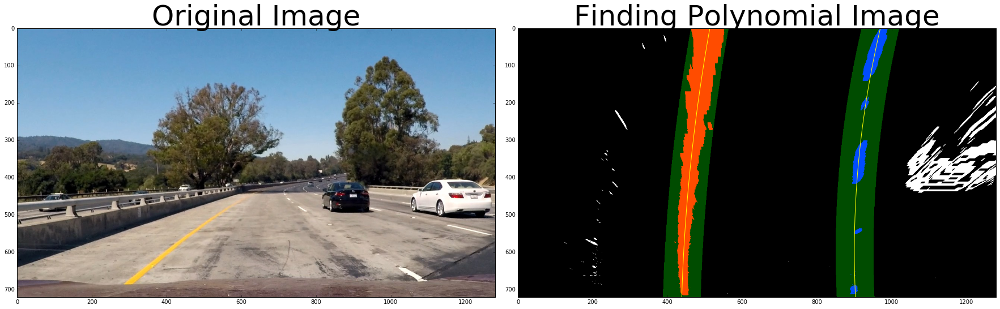

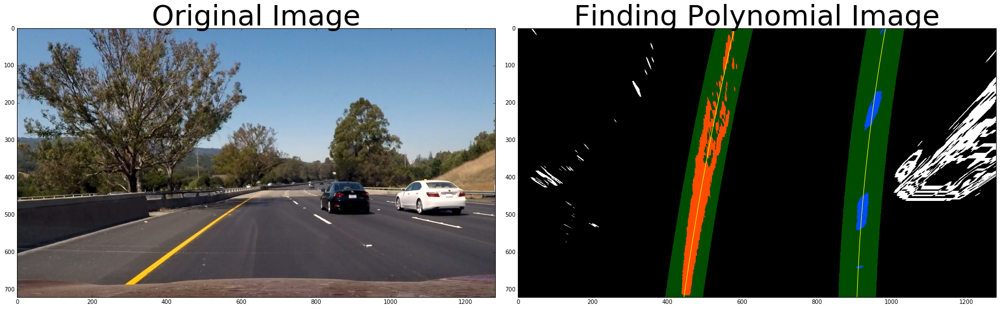

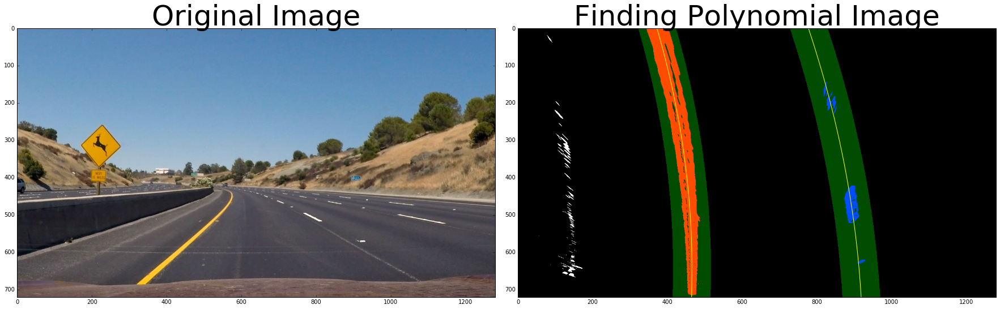

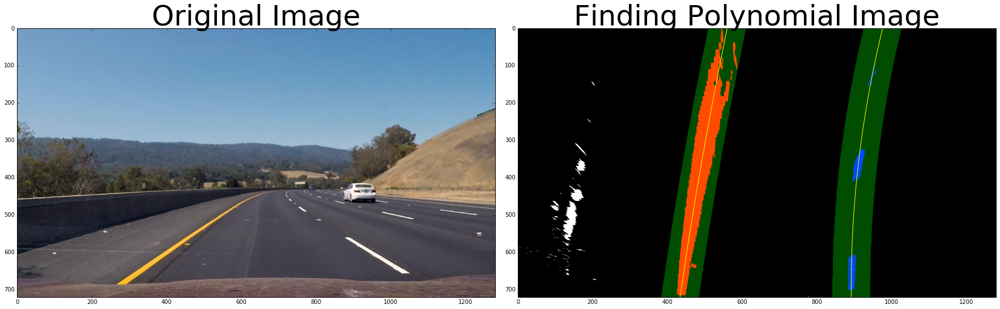

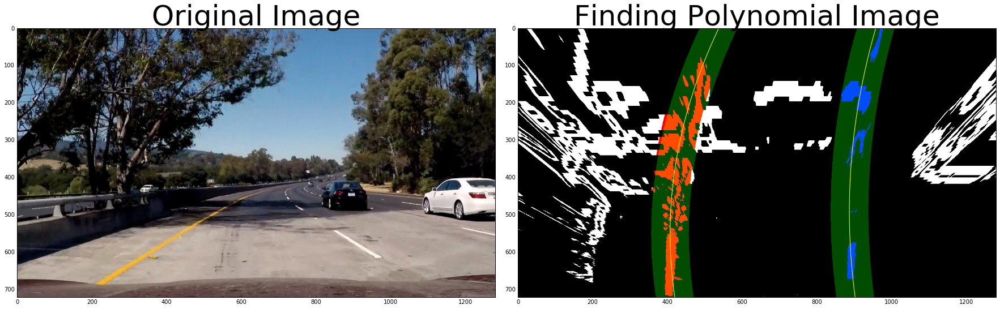

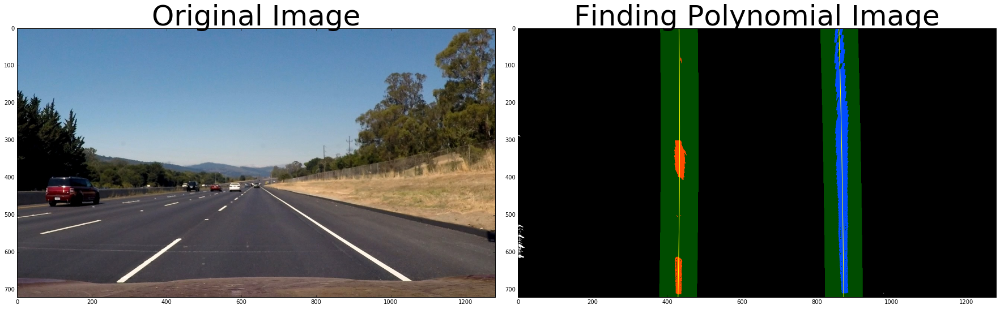

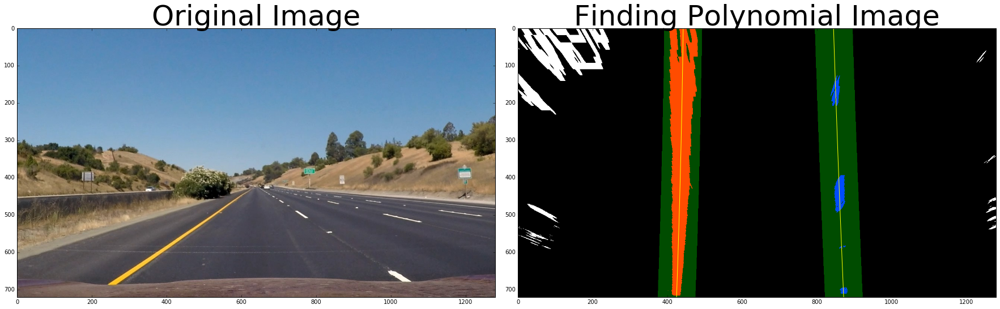

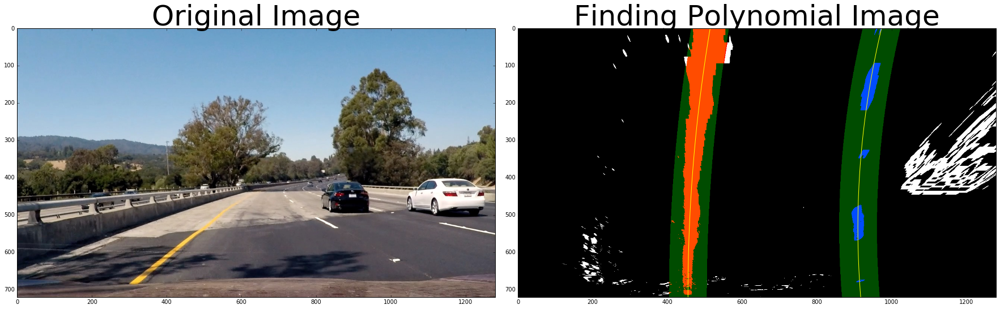

In [23]:
from AdvancedLaneFinding import find_lane_pixels

def search_around_poly_verbose(binary_warped, leftx, lefty, rightx, righty):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    margin = 50

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    left_fitx, right_fitx, ploty = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    # Plot the polynomial lines onto the image
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    ## End visualization steps ##
    
    return result
        
if(PERFORMONPICTURES):
    for fname in test_images:
        image = mping.imread(fname)

        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(image)
        ax1.set_title('Original Image', fontsize=50)
        test, Minv = Warp(Pipeline(image))
        leftx, lefty, rightx, righty = find_lane_pixels(test)
        result = search_around_poly_verbose(test, leftx,lefty, rightx, righty)
        ax2.imshow(result)
        ax2.set_title('Finding Polynomial Image', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        plt.show()

In [24]:

image = mping.imread(test_images[0])

binaryWarped, Minv = Warp(Pipeline(image))
warped = binaryWarped
leftx, lefty, rightx, righty = find_lane_pixels(binaryWarped)

left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)

ploty = np.linspace(0, image.shape[0]-1, image.shape[0])
y_eval = image.shape[0]
# Define y-value where we want radius of curvature
# I'll choose the maximum y-value, corresponding to the bottom of the image

##### TO-DO: Implement the calculation of R_curve (radius of curvature) #####
left_curverad = ((1+(2*left_fit[0]*y_eval+left_fit[1])**2)**(3/2))/(np.abs(2*left_fit[0]))  ## Implement the calculation of the left line here
right_curverad = ((1+(2*right_fit[0]*y_eval+right_fit[1])**2)**(3/2))/(np.abs(2*right_fit[0]))  ## Implement the calculation of the right line here
    
print(left_curverad, right_curverad)
# Example values: 1926.74 1908.48


def getCurvature(x, y, y_eval):
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    y_eval = ym_per_pix* y_eval
    
    fit = np.polyfit(y*ym_per_pix, x*xm_per_pix, 2)
    
    # Calculate radii of curvature
    curverad = ((1 + (2*fit[0]*y_eval + fit[1])**2)**1.5) / np.absolute(2*fit[0])
    return (curverad)

print("Average Curvature m")
print((getCurvature(leftx, lefty, np.max(ploty))+ getCurvature(rightx, righty, np.max(ploty)))/2.0)

4841.174114358699 2586.438356219297
Average Curvature m
1217.3942316633866


In [25]:
def getCenterOffset(left_fitx, right_fitx, center):
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    lane_center = (left_fitx[-1] + right_fitx[-1]) / 2.0
    return((lane_center - center) * xm_per_pix)

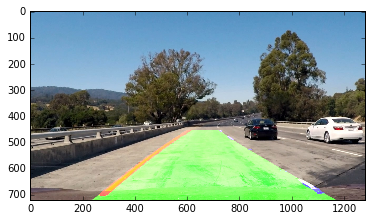

Left Curvature:  1584.7737680444054
Right Curvature:  844.8496192280076


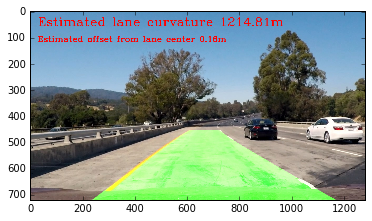

Left Curvature:  2546.4866860061425
Right Curvature:  1656.2122179038054


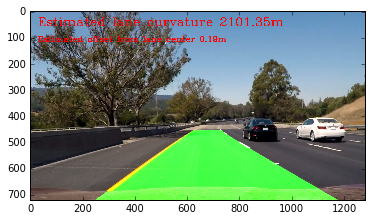

Left Curvature:  729.8086119051438
Right Curvature:  865.4362096585925


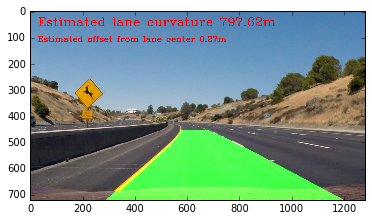

Left Curvature:  3722.3199384858663
Right Curvature:  941.8414962872621


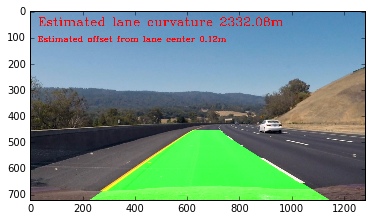

Left Curvature:  380.9415189769473
Right Curvature:  561.8375887284291


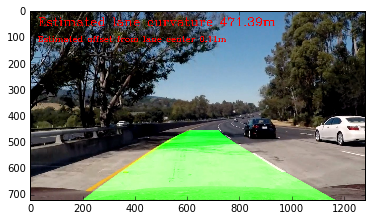

Left Curvature:  7554.262432328304
Right Curvature:  12175.6057548332


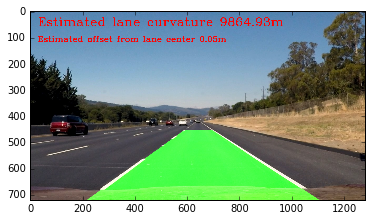

Left Curvature:  10450.770691368996
Right Curvature:  21056.120825292728


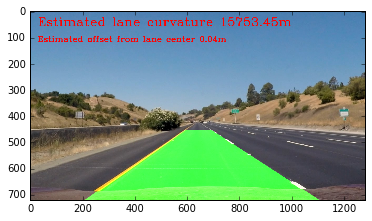

Left Curvature:  1398.1674023137869
Right Curvature:  744.6050844539833


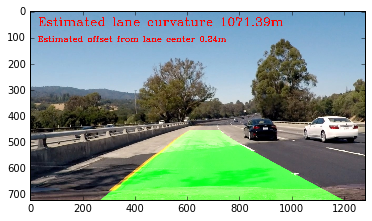

In [27]:
from AdvancedLaneFinding import search_around_poly
#Final Test
image = mping.imread(test_images[0])

binaryWarped, Minv = Warp(Pipeline(image))
leftx, lefty, rightx, righty = find_lane_pixels(binaryWarped)

left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)

leftx, lefty, rightx, righty = search_around_poly(binaryWarped, left_fit, right_fit)

left_fitx, right_fitx, ploty = fit_poly(binaryWarped.shape, leftx, lefty, rightx, righty)
# Create an image to draw the lines on
warp_zero = np.zeros_like(warped).astype(np.uint8)
color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

# Recast the x and y points into usable format for cv2.fillPoly()
pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
pts = np.hstack((pts_left, pts_right))

# Draw the lane onto the warped blank image
cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

color_warp[lefty, leftx] = [255, 0, 0]
color_warp[righty, rightx] = [0, 0, 255]
    
# Warp the blank back to original image space using inverse perspective matrix (Minv)
newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 

# Combine the result with the original image
result = cv2.addWeighted(image, 1, newwarp, 1.0, 0)
plt.imshow(result)
plt.show()

if(PERFORMONPICTURES):
    for fname in test_images:
        image = mping.imread(fname)
        
        binaryWarped, Minv = Warp(Pipeline(image))
        warped = binaryWarped
        leftx, lefty, rightx, righty = find_lane_pixels(binaryWarped)
        
        left_fit = np.polyfit(lefty, leftx, 2)
        right_fit = np.polyfit(righty, rightx, 2)

        leftx, lefty, rightx, righty = search_around_poly(binaryWarped, left_fit, right_fit)

        left_fitx, right_fitx, ploty = fit_poly(warped.shape, leftx, lefty, rightx, righty)

        # Create an image to draw the lines on
        warp_zero = np.zeros_like(warped).astype(np.uint8)
        color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

        # Recast the x and y points into usable format for cv2.fillPoly()
        pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
        pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
        pts = np.hstack((pts_left, pts_right))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

        # Warp the blank back to original image space using inverse perspective matrix (Minv)
        newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 

        # Combine the result with the original image
        result = cv2.addWeighted(image, 1, newwarp, 1.0, 0)
        
        avgCurvature = (getCurvature(leftx, lefty, np.max(ploty))+ getCurvature(rightx, righty, np.max(ploty)))/2.0
        print("Left Curvature: ",getCurvature(leftx, lefty, np.max(ploty)))
        print("Right Curvature: ",getCurvature(rightx, righty, np.max(ploty)))
        
        curvature = "Estimated lane curvature %.2fm" % avgCurvature
        distance_center = "Estimated offset from lane center %.2fm" % (getCenterOffset(left_fitx, right_fitx, result.shape[1]/2.0))
        
        font = cv2.FONT_HERSHEY_COMPLEX
        cv2.putText(result, curvature, (30,60), font, 1.5, (255,0,0), 2)
        cv2.putText(result, distance_center, (30,120), font, 1, (255,0,0), 2)      
        
        plt.imshow(result)
        plt.show()
        